In [1]:
# affichage des rectifications à faire pour être PEP8 compliant
# %load_ext pycodestyle_magic
# %pycodestyle_on

In [2]:
# librairies de base
from functions import *
import pandas as pd
import numpy as np
import warnings
from tqdm import tqdm
pd.options.mode.chained_assignment = None
warnings.filterwarnings('ignore')

In [3]:
# librairies de dataviz
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.graph_objs import *
from yellowbrick.cluster import SilhouetteVisualizer
from matplotlib.lines import Line2D
import squarify
sns.set()
%matplotlib inline

In [4]:
# Preprocessing
from sklearn.preprocessing import StandardScaler

# Dimensional Reduction
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Clustering
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering

# Score
from sklearn.metrics import silhouette_score, davies_bouldin_score

# 0. Initialisation
## 0.1 Chargement des données

In [5]:
data = pd.read_csv('cleaned_dataset.csv')

In [6]:
data.set_index('customer_unique_id', inplace=True)

## 0.2 Matrice de corrélation

<AxesSubplot:>

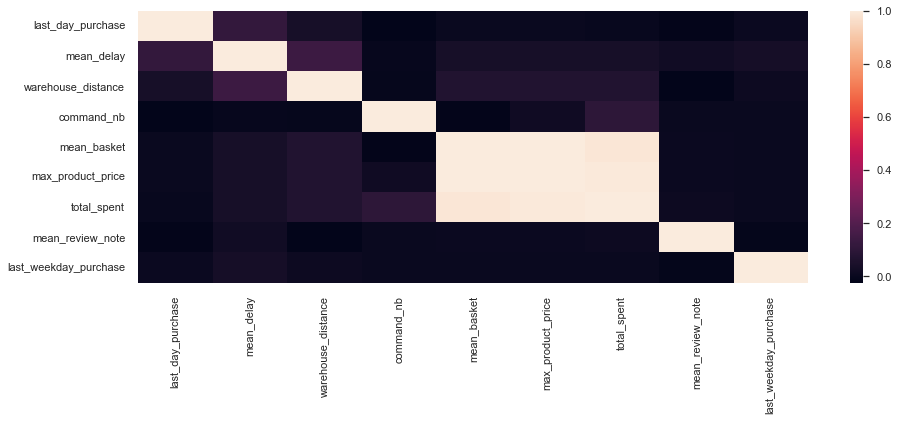

In [7]:
# Matrice de correlation des données
plt.figure(figsize=(15,
                    5))
sns.heatmap(data.corr())

## 0.3 Création d'un dataset simplifié à 3 variables

In [8]:
# Définition d'un dataset à 3 colonnes 'RFM' pour récence, fréquence, montant
data_RFM = data[['last_day_purchase',
                 'command_nb',
                 'mean_basket']]
data_RFM.set_axis(['recency',
                   'frequency',
                   'monetary'],
                  axis=1,
                  inplace=True)

In [9]:
data_RFM.head()

,recency,frequency,monetary
customer_unique_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,111,1,129.90
0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,18.90
0000f46a3911fa3c0805444483337064,536,1,69.00
0000f6ccb0745a6a4b88665a16c9f078,320,1,25.99
0004aac84e0df4da2b147fca70cf8255,287,1,180.00


## 0.4 Preprocessing

In [10]:
# Utilisation d'un transformeur pour que chaque variable
# ait le même poids lorsque l'on entrainera le modèle
X_scaled = StandardScaler().fit_transform(data_RFM)

In [11]:
def rescale(x):
    '''Permet de réduire les données sur une échelle de 0 à 1,
    avec la différence qu'il est possible de faire un .apply() avec celle-ci'''
    return (x - np.min(x)) / np.ptp(x)

# 1. Selection de modèle sur dataset simplifié
## 1.1 KMeans

Désormais, nous devons trouver pour chaque modèle que nous allons tester, les hyperparamètres optimaux. Dans le cas du KMeans, il s'agit de K, le nombre de clusters que nous souhaitons dans notre dataset. Pour le trouver, il existe une méthode de scoring, le Silhouette Score comprit entre 0 (mauvais) et 1 (excellent) et qui évalue la qualité de tous les clusters un par un. Nous allons donc créer une boucle permettant d'afficher ce score pour chaque K testé. Dans l'absolu il n'est qu'une aide à la décision partielle car c'est à nous de rendre intelligible les résultats pour chaque cluster.

### 1.1.1 Silhouette Score

Création d'une boucle pour associer un score silhouette pour chaque K testé

**Partie du code executée sur Google Colab :**

%pylab inline

silhouettes = []

for num_clusters in range(2,14):
    cls = KMeans(n_clusters=num_clusters)
    cls.fit(X_scaled)
    silh = silhouette_score(X_scaled,cls.labels_)
    silhouettes.append(silh)

plt.plot(range(2,14), silhouettes, marker='o')

In [106]:
# Voici le score pour un K allant de 2 à 14
silhKMeans = [0.7261299412194214,
              0.46053230147630386,
              0.49553846092457804,
              0.5057203244273732,
              0.4442993983758184,
              0.4468260285870324,
              0.45425156330786315,
              0.45486288372146194,
              0.40054148645440224,
              0.40619803079399036,
              0.41269582429681506,
              0.3784416636503138]

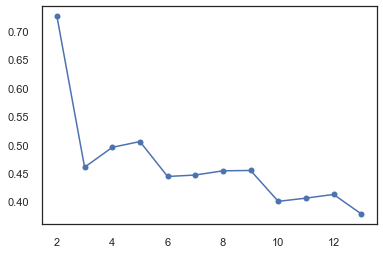

In [107]:
# Représenter l'évolution du Silhouette score
# en fonction de la valeur de l'hyperparamètre K
# (ici entre 2 et 13)
plt.plot(range(2,
               14),
         silhKMeans,
         marker='o')

### 1.1.2 Création du Kmeans avec ses hyperparamètres

In [125]:
# Création du modèle de KMeans avec l'hyperparamètre selectionné
kmeans = KMeans(n_clusters=5).fit(data_RFM)
kmeans

KMeans(n_clusters=5)

### 1.1.3 Représentation générique des données

In [126]:
# Représentation des données du dataset en 3D,
# ce qui est encore possible car nous n'avons que 3 variables
KMeans3D = go.Scatter3d(
    x=data_RFM.iloc[:, 2],
    y=data_RFM.iloc[:, 1],
    z=data_RFM.iloc[:, 0],
    marker=go.scatter3d.Marker(size=1),
    opacity=.5,
    mode='markers')

fig = go.Figure(KMeans3D)

# Divers paramètres d'affichage
fig.update_layout(width=700,
                  margin=dict(r=10,
                              l=10,
                              b=10,
                              t=10))
fig.update_layout(scene_aspectmode='auto')

fig.update_layout(scene=dict(
                  xaxis_title='RECENCY',
                  yaxis_title='FREQUENCY',
                  zaxis_title='MONETARY'),
                  width=700,
                  margin=dict(r=20,
                              b=10,
                              l=10,
                              t=10))

fig.show()

In [127]:
# Ajout des labels au dataframe 'RFM'
data_RFM['labels_kmeans'] = kmeans.labels_

### 1.1.4 Dataframe de la moyenne des clusters

In [128]:
# Créer un nouveau Dataframe faisant la moyenne
# à chaque cluster de chacune des caractéristiques
data_kmeans = (
    data_RFM.groupby('labels_kmeans').agg(
        avg_recency=('recency', np.mean),
        avg_frequency=('frequency', np.mean),
        avg_monetary=('monetary', np.mean)
    )
    .apply(lambda x: rescale(x))
    .reset_index()
)

### 1.1.5 Représentation par cluster des données

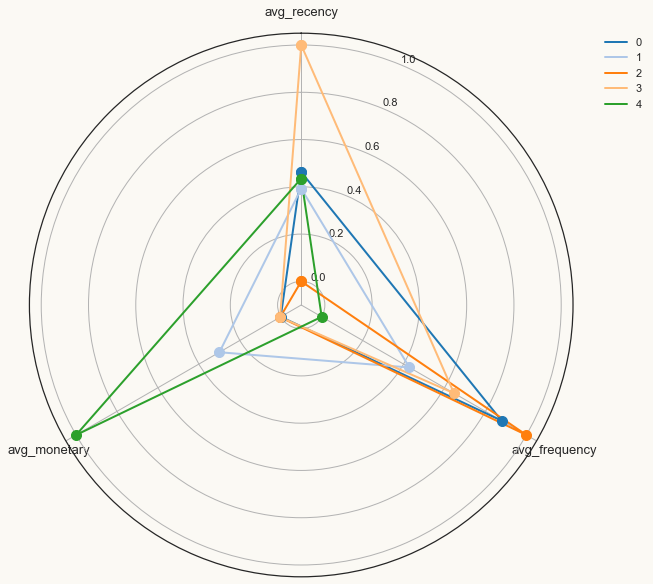

In [130]:
# Couleur du fond et palette de couleurs
WHITE = "#fbf9f4"
COLOURS = sns.color_palette('tab20')

# Le nom des clusters
CLUSTERS = data_kmeans["labels_kmeans"].values.tolist()

# Le nom des variables et leur longueur associée
VARIABLES = data_kmeans.columns.tolist()[1:]
VARIABLES_N = len(VARIABLES)

# L'angle où placer chaque variable sur le radar plot
ANGLES = [n / VARIABLES_N * 2 * np.pi for n in range(VARIABLES_N)]
ANGLES += ANGLES[:1]

# Création de la figure
fig = plt.figure(figsize=(14, 10))
plt.rc('grid', color="#b3b3b3", linewidth=1, linestyle='-')
ax = fig.add_subplot(111, polar=True)
fig.patch.set_facecolor(WHITE)
ax.set_facecolor(WHITE)

# Fixe la position de la première variable, à savoir avg_recency
ax.set_theta_offset(np.pi / 2)
ax.set_theta_direction(-1)

# Permet de garder la lisibilité des valeurs extrêmes (chevauchement)
ax.set_ylim(-0.1, 1.05)

# Tracer les lignes pour chaque cluster dans la figure
for idx, labels in enumerate(CLUSTERS):
    values = data_kmeans.iloc[idx].drop("labels_kmeans").values.tolist()
    values += values[:1]
    ax.plot(ANGLES,
            values,
            color=COLOURS[idx],
            linewidth=2,
            label=labels)
    ax.scatter(ANGLES, values, s=100, color=COLOURS[idx], zorder=10)
    ax.set_xticks(ANGLES[:-1])
    ax.set_xticklabels(VARIABLES)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    plt.xticks(fontsize=13)

In [131]:
# Représentation des données du dataset en 3D
KMeans3D = go.Scatter3d(
    x=data_RFM.iloc[:,
                    2],
    y=data_RFM.iloc[:,
                    1],
    z=data_RFM.iloc[:,
                    0],
    marker=go.scatter3d.Marker(size=1),
    opacity=.5,
    mode='markers')

# Catégorisation des données par cluster
fig = go.Figure()
for label in CLUSTERS:
    fig.add_trace(go.Scatter3d(x=data_RFM[
        data_RFM[
            'labels_kmeans'] == label].iloc[:,
                                            2],
                               y=data_RFM[data_RFM[
                                   'labels_kmeans'] == label].iloc[:,
                                                                   1],
                               z=data_RFM[data_RFM[
                                   'labels_kmeans'] == label].iloc[:,
                                                                   0],
                               opacity=1,
                               mode='markers',
                               marker=dict(colorscale='hot', size=1),
                               name=label))

# Divers paramètres d'affichage
fig.update_traces(legendgrouptitle=dict(text='Labels'))
fig.update_layout(width=700, margin=dict(r=10,
                                         l=10,
                                         b=10,
                                         t=10))
fig.update_layout(scene_aspectmode='auto')

fig.update_layout(scene=dict(xaxis_title='RECENCY',
                             yaxis_title='FREQUENCY',
                             zaxis_title='MONETARY'),
                  width=700,
                  margin=dict(r=20,
                              b=10,
                              l=10,
                              t=10))


fig.show()

## 1.2 DBSCAN

### 1.2.1 Silhouette Score

Création d'une boucle pour associer un score silhouette pour chaque hyperparamètre testé

**Partie du code executée sur Google Colab :**

%pylab inline

silhouettesDB = []

for k in np.arange(.20,.35,.05):
        cls2 = DBSCAN(eps=k,
                      min_samples=35,
                      n_jobs=-1)
        cls2.fit(X_scaled)
        silhDB = silhouette_score(X_scaled,cls2.labels_)
        silhouettesDB.append(silhDB)
        print(silhouettesDB)

In [112]:
# For min_sample = 35
silhDB = [0.36581222953170417,
          0.40937854569461896,
          0.43193984420435955,
          0.44980154849767034]

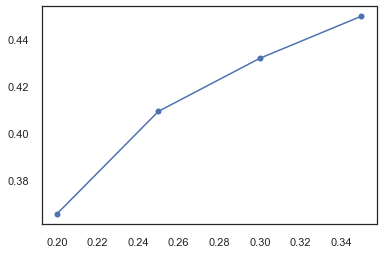

In [114]:
# Représenter l'évolution du Silhouette score
# en fonction de la valeur de l'hyperparamètre
# min sample (ici entre 20 et 40)
plt.plot(np.arange(0.20,
                   0.40,
                   0.05),
         silhDB,
         marker='o')

### 1.1.2 Création du DBSCAN avec ses hyperparamètres

In [119]:
# Création du modèle de DBSCAN avec les hyperparamètres selectionné
dbscan = DBSCAN(eps=.35,
                min_samples=35,
               n_jobs=-1)
dbscan.fit(X_scaled)

DBSCAN(eps=0.35, min_samples=35, n_jobs=-1)

### 1.1.3 Dataframe de la moyenne des clusters

In [120]:
# Ajout des labels au dataframe 'RFM'
data_RFM['labels_dbscan'] = dbscan.labels_

In [121]:
# Créer un nouveau Dataframe faisant la moyenne à chaque cluster de chacune des caractéristiques
data_dbscan = (
    data_RFM.groupby('labels_dbscan').agg(
        avg_recency=('recency', np.mean),
        avg_frequency=('frequency', np.mean),
        avg_monetary=('monetary', np.mean)
    )
    .apply(lambda x: rescale(x))
    .reset_index()
)

### 1.1.4 Représentation par cluster des données

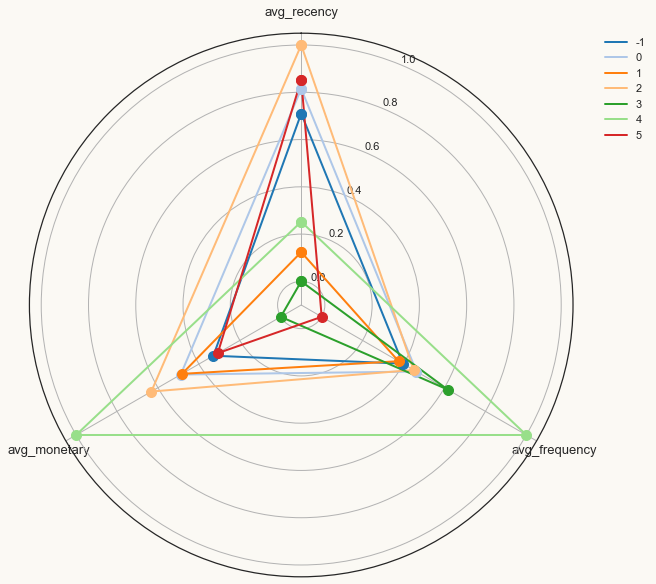

In [122]:
# Le nom des clusters
CLUSTERS = data_dbscan["labels_dbscan"].values.tolist()

# Le nom des variables et leur longueur associée
VARIABLES = data_dbscan.columns.tolist()[1:]
VARIABLES_N = len(VARIABLES)

# L'angle où placer chaque variable sur le radar plot
ANGLES = [n / VARIABLES_N * 2 * np.pi for n in range(VARIABLES_N)]
ANGLES += ANGLES[:1]

# Création de la figure
fig = plt.figure(figsize=(14, 10))
plt.rc('grid', color="#b3b3b3", linewidth=1, linestyle='-')
ax = fig.add_subplot(111, polar=True)
fig.patch.set_facecolor(WHITE)
ax.set_facecolor(WHITE)

# Fixe la position de la première variable, à savoir avg_recency
ax.set_theta_offset(np.pi / 2)
ax.set_theta_direction(-1)

# Permet de garder la lisibilité des valeurs extrêmes (chevauchement)
ax.set_ylim(-0.1, 1.05)

# Tracer les lignes pour chaque cluster dans la figure
for idx, labels in enumerate(CLUSTERS):
    values = data_dbscan.iloc[idx].drop("labels_dbscan").values.tolist()
    values += values[:1]
    ax.plot(ANGLES,
            values,
            color=COLOURS[idx],
            linewidth=2,
            label=labels)
    ax.scatter(ANGLES, values, s=100, color=COLOURS[idx], zorder=10)
    ax.set_xticks(ANGLES[:-1])
    ax.set_xticklabels(VARIABLES)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    plt.xticks(fontsize=13)

In [123]:
# Représentation des données du dataset en 3D
KMeans3D = go.Scatter3d(x=data_RFM.iloc[:,
                                        2],
                        y=data_RFM.iloc[:,
                                        1],
                        z=data_RFM.iloc[:,
                                        0],
                        marker=go.scatter3d.Marker(size=1),
                        opacity=.5,
                        mode='markers')
fig = go.Figure()

# Catégorisation des données par cluster
for label in CLUSTERS:
    fig.add_trace(go.Scatter3d(
        x=data_RFM[data_RFM['labels_dbscan'] == label].iloc[:,
                                                            2],
        y=data_RFM[data_RFM['labels_dbscan'] == label].iloc[:,
                                                            1],
        z=data_RFM[data_RFM['labels_dbscan'] == label].iloc[:,
                                                            0],
        opacity=1,
        mode='markers',
        marker=dict(colorscale='hot',
                    size=1),
        name=label))

# Divers paramètres d'affichage
fig.update_traces(legendgrouptitle=dict(text='Labels'))

fig.update_layout(width=700,
                  margin=dict(r=10,
                              l=10,
                              b=10,
                              t=10))

fig.update_layout(scene_aspectmode='auto')

fig.update_layout(scene=dict(xaxis_title='RECENCY',
                             yaxis_title='FREQUENCY',
                             zaxis_title='MONETARY'),
                  width=700,
                  margin=dict(r=20,
                              b=10,
                              l=10,
                              t=10))

fig.show()

## 2.3 Clustering Agglomératif

### 1.1.1 Simplification du dataset (index)

In [27]:
# Utilisation du KMeans pour réduire le nombre de clients à 1000 clients représentatifs de la population afin de pouvoir faire tourner plus facilement la boucle de recherche du K optimal
reduced_dimension = KMeans(n_clusters=1000).fit(X_scaled)

In [28]:
# Assignation à une catégorie de client pour chaque individu
data_RFM['representative'] = reduced_dimension.labels_

In [29]:
# Création d'un client type représentant sa catégorie de client
data_reduced = data_RFM.groupby('representative').agg(
        avg_recency=('recency', np.mean),
        avg_frequency=('frequency', np.mean),
        avg_monetary=('monetary', np.mean)).reset_index()

In [115]:
# Boucle permettant de définir le nombre de clusters ayant le meilleur score possible
%pylab inline

silhouettecah = []

for num_clusters in range(2,14):
    clscah = AgglomerativeClustering(distance_threshold=None,
                                  n_clusters=num_clusters)
    clscah.fit(data_reduced)
    silh = silhouette_score(data_reduced,clscah.labels_)
    silhouettecah.append(silh)

Populating the interactive namespace from numpy and matplotlib


### 1.1.2 Silhouette Score

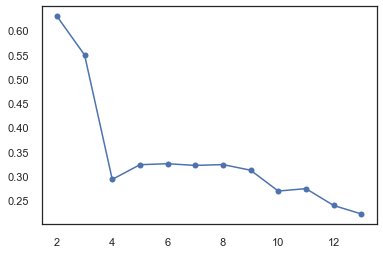

In [116]:
# Représenter l'évolution du Silhouette score en fonction de la valeur de l'hyperparamètre K (ici entre 2 et 13)
plt.plot(range(2,
               14),
         silhouettecah,
         marker='o')

### 1.1.3 Création du AgglomerativeClustering avec ses hyperparamètres

In [32]:
# Création du modèle de AgglomerativeClustering
# avec l'hyperparamètre selectionné
cah = AgglomerativeClustering(distance_threshold=None,
                              n_clusters=5).fit(data_reduced)
cah

AgglomerativeClustering(n_clusters=5)

In [33]:
# Ajout des labels au dataframe 'reduced'
data_reduced['labels_CAH'] = cah.labels_

### 1.1.4 Généralisation du clustering à l'ensemble des clients

In [34]:
# Application des labels des 1000 représentants à l'ensemble des clients
data_RFM = pd.merge(data_reduced[['representative',
                                  'labels_CAH']].reset_index(drop=True),
                    data_RFM.reset_index(),
                    on='representative').drop(['representative'],
                                              axis=1)

In [35]:
# Réorganisation des colonnes afin de faciliter l'affichage du plot
data_RFM = data_RFM.reindex(columns=['recency',
                                     'frequency',
                                     'monetary',
                                     'labels_kmeans',
                                     'labels_dbscan',
                                     'labels_CAH'])

### 1.1.5 Dataframe de la moyenne des clusters

In [36]:
# Créer un nouveau Dataframe faisant la moyenne
# à chaque cluster de chacune des caractéristiques
data_cah = (
    data_RFM.groupby('labels_CAH').agg(
        avg_recency=('recency', np.mean),
        avg_frequency=('frequency', np.mean),
        avg_monetary=('monetary', np.mean)
    )
    .apply(lambda x: rescale(x))
    .reset_index()
)

### 1.1.6 Représentation par cluster des données

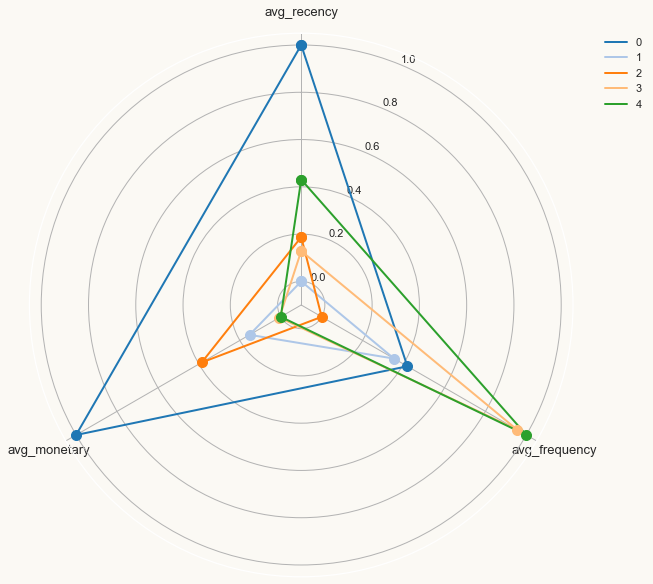

In [37]:
# Le nom des clusters
CLUSTERS = data_cah["labels_CAH"].values.tolist()

# Le nom des variables et leur longueur associée
VARIABLES = data_cah.columns.tolist()[1:]
VARIABLES_N = len(VARIABLES)

# L'angle où placer chaque variable sur le radar plot
ANGLES = [n / VARIABLES_N * 2 * np.pi for n in range(VARIABLES_N)]
ANGLES += ANGLES[:1]

# Création de la figure
fig = plt.figure(figsize=(14, 10))
plt.rc('grid', color="#b3b3b3", linewidth=1, linestyle='-')
ax = fig.add_subplot(111, polar=True)
fig.patch.set_facecolor(WHITE)
ax.set_facecolor(WHITE)

# Fixe la position de la première variable, à savoir avg_recency
ax.set_theta_offset(np.pi / 2)
ax.set_theta_direction(-1)

# Permet de garder la lisibilité des valeurs extrêmes (chevauchement)
ax.set_ylim(-0.1, 1.05)

# Tracer les lignes pour chaque cluster dans la figure
for idx, labels in enumerate(CLUSTERS):
    values = data_cah.iloc[idx].drop("labels_CAH").values.tolist()
    values += values[:1]
    ax.plot(ANGLES,
            values,
            color=COLOURS[idx],
            linewidth=2,
            label=labels)
    ax.scatter(ANGLES, values, s=100, color=COLOURS[idx], zorder=10)
    ax.set_xticks(ANGLES[:-1])
    ax.set_xticklabels(VARIABLES)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    plt.xticks(fontsize=13)

In [38]:
# Représentation des données du dataset en 3D
KMeans3D = go.Scatter3d(x=data_RFM.iloc[:,
                                        2],
                        y=data_RFM.iloc[:,
                                        1],
                        z=data_RFM.iloc[:,
                                        0],
                        marker=go.scatter3d.Marker(size=1),
                        opacity=.5,
                        mode='markers')
fig = go.Figure()

# Catégorisation des données par cluster
for label in CLUSTERS:
    fig.add_trace(go.Scatter3d(
        x=data_RFM[data_RFM['labels_CAH'] == label].iloc[:,
                                                         2],
        y=data_RFM[data_RFM['labels_CAH'] == label].iloc[:,
                                                         1],
        z=data_RFM[data_RFM['labels_CAH'] == label].iloc[:,
                                                         0],
        opacity=1,
        mode='markers',
        marker=dict(colorscale='hot',
                    size=1),
        name=label))

# Divers paramètres d'affichage
fig.update_traces(legendgrouptitle=dict(text='Labels'))
fig.update_layout(width=700, margin=dict(r=10,
                                         l=10,
                                         b=10,
                                         t=10))

fig.update_layout(scene_aspectmode='auto')

fig.update_layout(scene=dict(xaxis_title='RECENCY',
                             yaxis_title='FREQUENCY',
                             zaxis_title='MONETARY'),
                  width=700,
                  margin=dict(r=20,
                              b=10,
                              l=10,
                              t=10))


fig.show()

# 2. Préparation pour le modèle final
## 2.1. Choix de l'algorithme

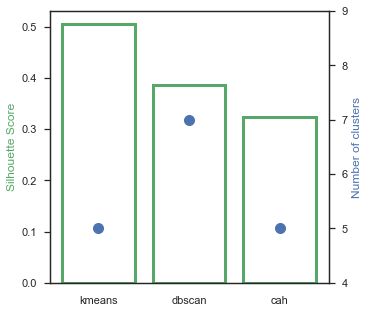

In [136]:
sns.set_style('white')

dict_silh = {'kmeans' : silhKMeans[3],
             'dbscan' : 0.386219673537887,
             'cah' : silhouettecah[3]}

dict_clust = {'kmeans' : 5,
              'dbscan' : 7,
              'cah' : 5}
fig, ax1 = plt.subplots(figsize=(5,
                                 5))
ax2 = ax1.twinx()
ax1.bar(dict_silh.keys(),
        dict_silh.values(),
        color='black',
        facecolor='None',
        edgecolor='g',
        linewidth='3')
ax2.scatter(dict_clust.keys(),
            dict_clust.values(),
            c='b',
            s=100)
ax1.set_ylabel('Silhouette Score',
               color='g')
ax2.set_ylabel('Number of clusters',
               color='b')
ax2.set_yticks(range(4,
                     10))
plt.show()

**Note :** *L'algorithme  qui offre le plus de variété et de compréhension dans son découpage en cluster et utilisant le moins de CPU est l'algorithme des KMeans. C'est donc celui-ci que l'on va utiliser pour élargir les dimensions du dataset.*

## 2.2. PCA

In [40]:
n_comp = data.shape[1]
pca = PCA(n_components=n_comp)

In [41]:
X_projected = pca.fit_transform(data)
pcs = pca.components_

In [42]:
def display_scree_plot(pca):
    '''
    Décrit le pourcentage d’inertie totale associé
    à chaque axe de manière cumulative.
    '''
    scree = pca.explained_variance_ratio_*100
    plt.bar(np.arange(len(scree))+1, scree)
    plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
    plt.xlabel("rang de l'axe d'inertie")
    plt.ylabel("pourcentage d'inertie")
    plt.title("Eboulis des valeurs propres")
    plt.show(block=False)

In [43]:
data.columns.tolist()

['last_day_purchase',
 'mean_delay',
 'warehouse_distance',
 'command_nb',
 'mean_basket',
 'max_product_price',
 'total_spent',
 'mean_review_note',
 'last_weekday_purchase']

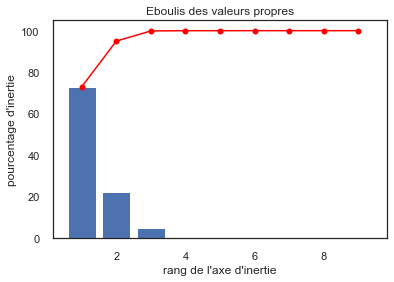

In [44]:
display_scree_plot(pca)

In [48]:
data_pca = data.drop(['command_nb',
                      'mean_basket',
                      'mean_review_note',
                      'last_weekday_purchase',
                      'mean_delay'],
                     axis=1)

In [49]:
data_pca.columns.tolist()

['last_day_purchase', 'warehouse_distance', 'max_product_price', 'total_spent']

In [50]:
n_comp_r = data_pca.shape[1]
pca_r = PCA(n_components=n_comp_r)

In [51]:
X_projected = pca_r.fit_transform(data_pca)
pcs_r = pca_r.components_

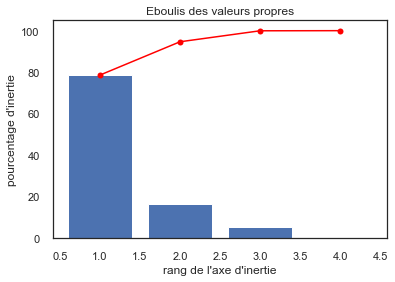

In [52]:
display_scree_plot(pca_r)

les variables selectionnées expliquent 93% de la variance.


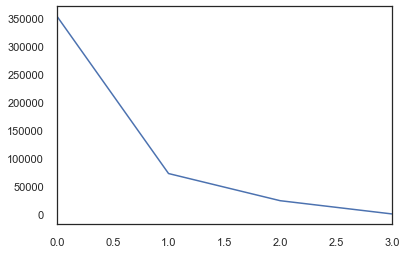

In [53]:
# 4 variables ayant le plus de variance
print('les variables selectionnées expliquent {:.0f}% de la variance.'.format((pca_r.explained_variance_.sum())/(pca.explained_variance_.sum())*100))

plt.xlim((0,
          3))
plt.plot(pca_r.explained_variance_)

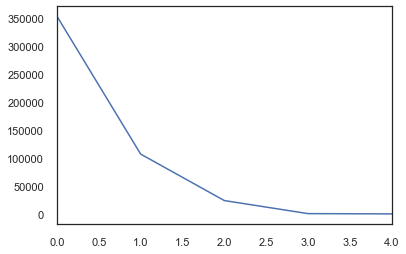

In [54]:
# Variance expliquée avec toutes les variables
plt.xlim((0,
          4))
plt.plot(pca.explained_variance_)

## 2.3. Préparation du jeu de données complet

In [55]:
final_features = [  # RFM,
                  'command_nb',
                  'last_day_purchase',
                  'mean_basket',
                    # explained variance features,
                  'max_product_price',
                  'total_spent',
                  'warehouse_distance',
                    # behavioural feature,
                  'mean_review_note',
                  'mean_delay'
                  ]

In [56]:
data_final = data[final_features]

In [57]:
n_comp = data_final.shape[1]
pca_f = PCA(n_components=n_comp)

In [58]:
X_projected = pca_f.fit_transform(data_final)
pcs = pca_f.components_

les variables selectionnées expliquent 100% de la variance.


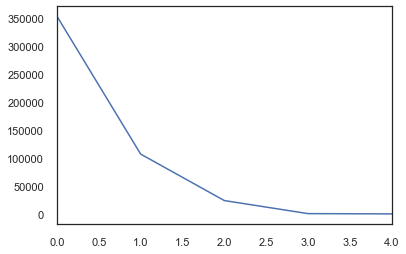

In [59]:
# Variance expliquée avec toutes les variables
print('les variables selectionnées expliquent {:.0f}% de la variance.'.format((pca_f.explained_variance_.sum())/(pca.explained_variance_.sum())*100))
plt.xlim((0,
          4))
plt.plot(pca_f.explained_variance_)

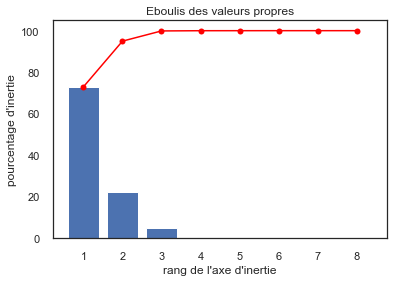

In [60]:
display_scree_plot(pca_f)

## 2.4. Matrice de corrélation

<AxesSubplot:>

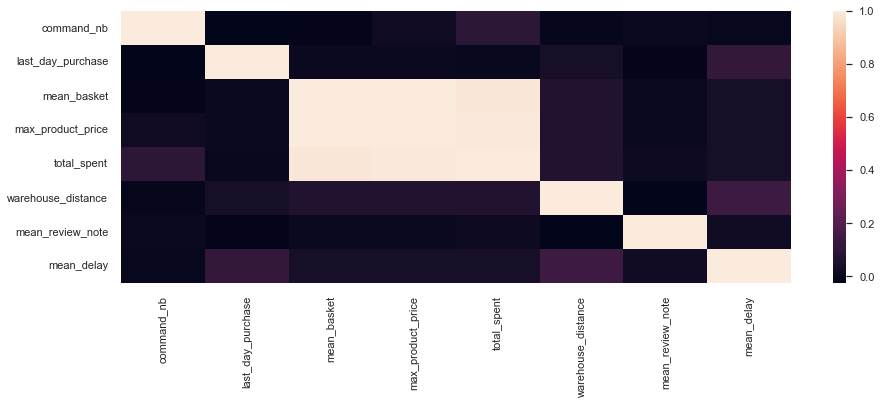

In [61]:
plt.figure(figsize=(15,
                    5))
sns.heatmap(data_final.corr())

## 2.5. Preprocessing

In [62]:
X = StandardScaler().fit_transform(data_final)

# 3. Modèle final
## 3.1 Silhouette Score

Création d'une boucle pour associer un score silhouette pour chaque K testé

**Partie du code executée sur Google Colab :**

%pylab inline

silhouettes = []

for num_clusters in tqdm(range(2,8)):
    cls = KMeans(n_clusters=num_clusters)
    cls.fit(X)
    silh = silhouette_score(X,cls.labels_)
    silhouettes.append(silh)

In [137]:
# Résultat de la recherche du k optimal (pour k=6)
# num_clusters in range(2,8)

silhouettes = [0.7261299412194214,
               0.4607168477159083,
               0.4956989588761903,
               0.5056156618325113,
               0.44431098135003283,
               0.4469544516756782]

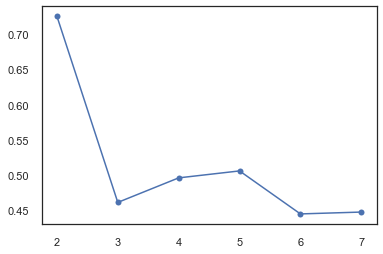

In [138]:
# Représenter l'évolution du Silhouette score
# en fonction de la valeur de l'hyperparamètre K
# (ici entre 2 et 7)
plt.plot(range(2,
               8),
         silhouettes,
         marker='o')

## 3.2 Score Davies Bouldin

Afin de d'affiner la recherche du K optimal, il existe une autre méthode de scoring appelée Score Davies Bouldin, qui mesure cette fois la similarité entre clusters. Plus il se rapproche de 0 et plus les clusters ont différentes distance inter et intra-clusters, ainsi qu'une dispersion différente des points.

In [65]:
dbs_iteration = []
for i in range(2,
               8):
    dbs = davies_bouldin_score(X=data_final,
                               labels=list(KMeansMaker(data_final,
                                                       i).labels))
    dbs_iteration.append([i,
                          dbs])
data_dbs = pd.DataFrame(dbs_iteration,
                        columns=["K",
                                 "score"])

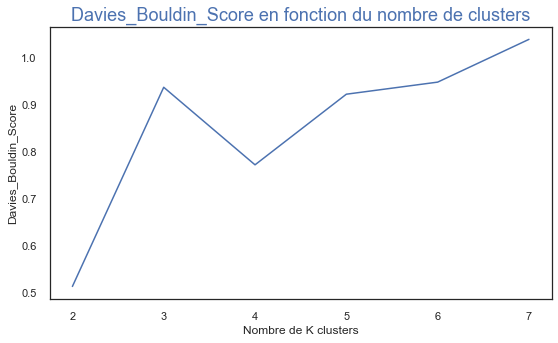

In [66]:
# Représenter l'évolution du score Davies Bouldin
# en fonction de la valeur de l'hyperparamètre K
# (ici entre 2 et 7)
fig = plt.figure(figsize=(9,
                          5))
sns.lineplot(data=data_dbs,
             x="K",
             y="score")

plt.xticks(data_dbs.K)
plt.xlabel("Nombre de K clusters")
plt.ylabel("Davies_Bouldin_Score")
plt.title("Davies_Bouldin_Score en fonction du nombre de clusters",
          fontsize=18,
          color="b")
plt.show()

Si l'on compare les 2 scores, il semble probable d'obtenir des résultats satisfaisant lorsque K=4. Essayons :

## 3.3 Création du Kmeans avec ses hyperparamètres

In [86]:
# Création du modèle de KMeans avec l'hyperparamètre selectionné
clustering = KMeans(n_clusters=4).fit(data_final)

In [87]:
# Ajout des labels au dataframe contenant toutes les variables
data_final['labels'] = clustering.labels_

## 3.4  Dataframe de la moyenne des clusters

In [88]:
# Créer un nouveau Dataframe faisant la moyenne
# à chaque cluster de chacune des caractéristiques
data_final_kmeans = (
    data_final.groupby('labels').agg(
        avg_frequency=('command_nb', np.mean),
        avg_satisfaction=('mean_review_note', np.mean),
        max_capacity=('max_product_price', np.mean),
        avg_monetary=('mean_basket', np.mean),
        mean_delay=('mean_delay', np.mean),
        oldness=('last_day_purchase', np.mean),
        distance=('warehouse_distance',np.mean)
    )
    .apply(lambda x: rescale(x))
    .reset_index()
)

In [92]:
def LabelsName(data):
    '''
    Permet de nommer chaque cluster
    en fonction d'une de ses caractéristiques
    les plus clivantes
    '''
    if data['avg_monetary'] >= 0.9 : return 'Mécène'
    
    elif data['oldness'] >= .9 : return 'Passager'
    
    elif data['distance'] <= 0 : return 'Micro-acheteur'
    
    else : return 'Moyen'

In [93]:
# Renommage des labels par une caractéristique principale
# définie grâce au radar plot ci-dessous
data_final_kmeans['labels'] = data_final_kmeans.apply(LabelsName, axis=1)

## 3.5 Interprétation des clusters

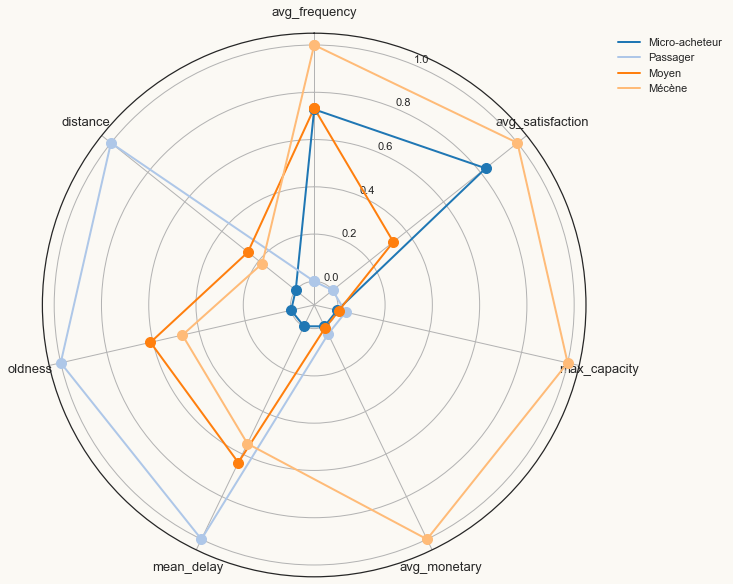

In [94]:
# Le nom des clusters
CLUSTERS = data_final_kmeans["labels"].values.tolist()
CLUSTERS_N = np.arange(0, len(CLUSTERS))

# Le nom des variables et leur longueur associée
VARIABLES = data_final_kmeans.columns.tolist()[1:]
VARIABLES_N = len(VARIABLES)

# L'angle où placer chaque variable sur le radar plot
ANGLES = [n / VARIABLES_N * 2 * np.pi for n in range(VARIABLES_N)]
ANGLES += ANGLES[:1]

# Création de la figure
fig = plt.figure(figsize=(14, 10))
plt.rc('grid', color="#b3b3b3", linewidth=1, linestyle='-')
ax = fig.add_subplot(111, polar=True)
fig.patch.set_facecolor(WHITE)
ax.set_facecolor(WHITE)

# Fixe la position de la première variable, à savoir avg_frequency
ax.set_theta_offset(np.pi / 2)
ax.set_theta_direction(-1)

# Permet de garder la lisibilité des valeurs extrêmes (chevauchement)
ax.set_ylim(-0.1, 1.05)

# Tracer les lignes pour chaque cluster dans la figure
for idx, labels in enumerate(CLUSTERS):
    values = data_final_kmeans.iloc[idx].drop("labels").values.tolist()
    values += values[:1]
    ax.plot(ANGLES,
            values,
            color=COLOURS[idx],
            linewidth=2,
            label=labels)
    ax.scatter(ANGLES, values, s=100, color=COLOURS[idx], zorder=10)
    ax.set_xticks(ANGLES[:-1])
    ax.set_xticklabels(VARIABLES)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    plt.xticks(fontsize=13)

- **Micro-acheteur** : Client régulier n'allouant qu'un faible budget moyen. Il est fidèle mais représente peu de chiffre d'affaires, achète local et de petites quantités.

- **Passager** : Client ayant manifesté de la satisfaction mais le fait qu'il soit très loin avec d'importants retards compréhensible rendent sa fidélité impossible

- **Mécène** : Représente le plus gros des montants, coeur de cible, satisfait, client régulier

- **Client Moyen** : Capacité et dépense plutôt faible, peu de satisfaction pour un peu de fréquence, il n'est pas le coeur de cible et le rapporte pas beaucoup à l'entreprise.

## 3.6 Représentation de l'efficacité de la segmentation

In [95]:
# Redisposition des clients sur un espace en 2 dimensions
# afin de faciliter la visualisation des clusters dans l'espace
X_TSNE = TSNE(n_components=3,
            perplexity=100,
            n_iter=300,
            n_jobs=-1).fit_transform(data_final)

In [96]:
t_SNE_labels = pd.concat([pd.DataFrame(X_TSNE).reset_index(drop=True),
                          data_final['labels'].reset_index(drop=True)],axis=1)

In [97]:
fig = go.Figure()
for idx, label in enumerate(CLUSTERS):
    fig.add_trace(go.Scatter3d(x=t_SNE_labels[t_SNE_labels[
                                   'labels'] == idx].iloc[:,
                                                            0],
                               y=t_SNE_labels[t_SNE_labels[
                                   'labels'] == idx].iloc[:,
                                                            1],
                               z=data_RFM[t_SNE_labels[
                                   'labels'] == idx].iloc[:,
                                                            2],
                               opacity=1,
                               mode='markers',
                               marker=dict(colorscale='hot', size=1),
                               name=label))

# Divers paramètres d'affichage
fig.update_traces(legendgrouptitle=dict(text='Labels'))
fig.update_layout(width=700, margin=dict(r=10,
                                         l=10,
                                         b=10,
                                         t=10))
fig.update_layout(scene_aspectmode='auto')
fig.show()

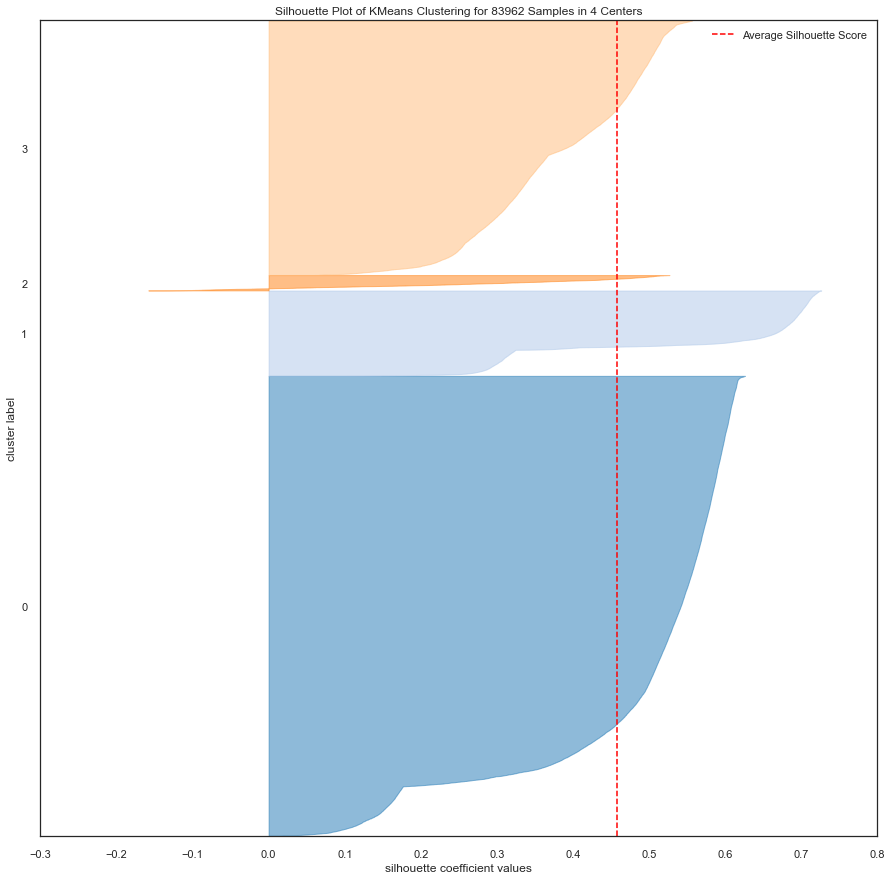

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 83962 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [103]:
# Visualisation de la densité des clusters par calcul 
model = KMeans(4)
plt.figure(figsize=(15,
                    15))
visualizer = SilhouetteVisualizer(model,
                                  colors=COLOURS)
visualizer.fit(data_final)
visualizer.poof()

**Note :** *Il semble que 4 des 5 clusters soient particulièrement homogènes.*

In [104]:
# Création d'un dataframe comptant
# le nombre de client par clusters
count = data_final.groupby(
    'labels').agg('count').iloc[:,
                                0].rename(
    'count').reset_index()
data_count = data_final_kmeans.merge(count,
                                     left_index=True,
                                     right_index=True)

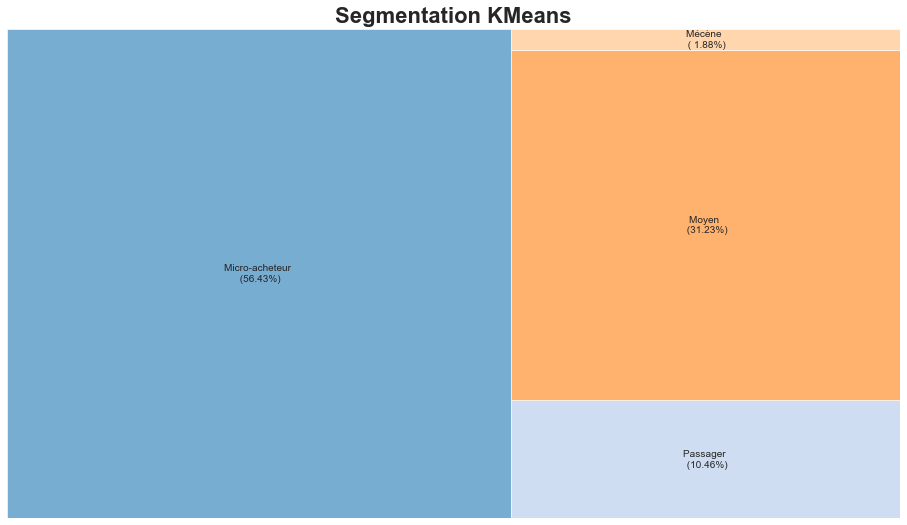

In [105]:
# Représentation de la répartition en pourcentage des clients
fig = plt.gcf()
ax = fig.add_subplot()
fig.set_size_inches(16,
                    9)
percentage = [f'{i/data_count["count"].sum()*100:5.2f}%'
              for i in data_count["count"]]
label = [f'{lb[0]} \n ({lb[1]})'
         for lb in zip(data_count['labels_x'],
                       percentage)]
squarify.plot(sizes=data_count["count"],
              label=label,
              color=COLOURS,
              alpha=.6)
plt.title('Segmentation KMeans',
          fontsize=22,
          fontweight="bold")
plt.axis("off")
plt.show()

In [101]:
# Nombre de clients par clusters
for index, label in zip(CLUSTERS,
                        data_count['count']):
    print(index,
          ' : {}'.format(label))

Micro-acheteur  : 47381
Passager  : 8783
Moyen  : 26218
Mécène  : 1580


In [102]:
# Nombre de clients
data_final.shape[0]

83962